# TRABAJO FINAL- SEMINARIO PYTHON DEEP

__Nombre y Apellido:__ Joaquín Haspert
__DNI:__ 35415942
__Legajo:__ 26788
__Email:__ joaco.has@gmail.com


+ Este trabajo tiene como objetivo predecir el genero musical de una canción a través del desarrollo y entrenamiento de una red neuronal convolucional mediante las funciones de Keras.

En las siguientes 3 secciones se importan las librerias y el modelo entrenado.

In [1]:
import os
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.cm as cm
from matplotlib.colors import Normalize
from matplotlib.backends.backend_agg import FigureCanvasAgg as FigureCanvas
import librosa
from pydub import AudioSegment
import shutil
import random
from keras.preprocessing.image import ImageDataGenerator
from keras.preprocessing.image import load_img, img_to_array
from keras.layers import (Input, Dense, Activation, BatchNormalization, Flatten,
                          Conv2D, MaxPooling2D, Dropout)
from keras.models import Model, load_model
from tensorflow.keras.optimizers import Adam
from PIL import Image
import IPython.display as ipd

In [2]:
source_dir = 'Machine-Learning/Music-Genre-Classification/'

In [3]:
model_file = os.path.join(source_dir,'results','genre.h5')

## Pista de audio

A continuación se sugieren canciones de distinto género para probar el modelo predictivo.

In [4]:
rock = 'the-rolling-stones-love-is-strong'
classic = 'tocata y fuga-Bach'
pop = 'Rihanna_feat_Jay_Z_-_Umbrella'
blues = 'Buddy Guy - Stay Around A Little Longer (Official Video) ft. B.B. King'
country = 'Otis-Taylor-Ten-Million-Slaves'
hiphop = 'JAY-Z - On To The Next One ft. Swizz Beatz'
reggae = 'Bob Marley - One Love'
disco = 'YMCA - Village People'
metal = 'Metallica - Enter Sandman'

Complete "filename" con el nombre de la canción o con el género a evaluar:

In [10]:
filename = rock

Podrá reproducir el audio y visualizar la forma de onda de la muestra.

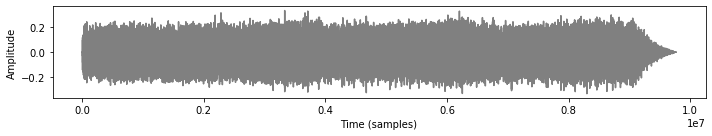

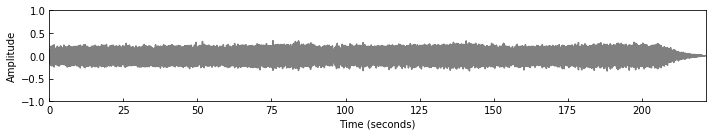

In [11]:
def convert_mp3_to_wav(source_dir,filename):
    # Load audio into PyDub
    song_m = os.path.join(source_dir,'results',filename+'.mp3')
    mp3 = AudioSegment.from_mp3(song_m)
    # Save
    song_w = os.path.join(source_dir,'results',filename+'.wav')
    mp3.export(song_w, format="wav")

convert_mp3_to_wav(source_dir,filename)


Fs = 44100

f = os.path.join(source_dir,'results',filename+'.wav')
x,Fs = librosa.load(f,sr=Fs)

ipd.display(ipd.Audio(x, rate=Fs))

plt.figure(figsize=(10,2))
plt.plot(x,color='gray')
plt.xlabel('Time (samples)')
plt.ylabel('Amplitude')
plt.tight_layout()

n = np.arange(x.shape[0])
t = n/Fs
plt.figure(figsize=(10,2))
plt.plot(t,x,color='gray')
plt.xlabel('Time (seconds)')
plt.ylabel('Amplitude')
plt.xlim([t[0],t[-1]])
plt.ylim([-1,1])
plt.tick_params(direction='in')
plt.tight_layout()

## Predicción

A continuación se realiza la predicción del género musical para la muestra evaluada. 

(288, 432, 4)
(1, 9)
[9.6753638e-07 1.8985763e-02 2.9763268e-02 3.1243084e-02 3.5946646e-03
 3.2573640e-02 1.0740533e-02 4.6542864e-03 8.6844385e-01]
8
The Genre of Song is --> rock


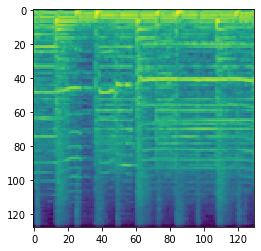

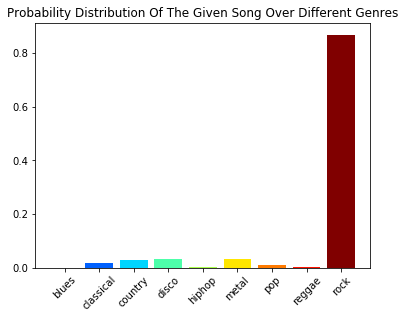

In [12]:
def extract_relevant(source_dir,filename,t1,t2):
    # Load audio into PyDub
    song_w = os.path.join(source_dir,'results',filename+'.wav')
    wav = AudioSegment.from_wav(song_w)
    # Slice audio (miliseconds)
    wav = wav[1000*t1:1000*t2]
    # Save
    split_song = os.path.join(source_dir,'results','split_'+filename+'.wav')
    wav.export(split_song, format='wav')

def create_melspectrogram(source_dir,filename):
    # Load audio into Librosa
    split_song = os.path.join(source_dir,'results','split_'+filename+'.wav')
    y, sr = librosa.load(split_song, duration=3)
    mel_spect = librosa.feature.melspectrogram(y, sr)
    mel_spect_dB = librosa.power_to_db(mel_spect, ref=np.max)
    fig = plt.Figure()
    canvas = FigureCanvas(fig)
    p = plt.imshow(mel_spect_dB)
    # Save 
    split_spect = os.path.join(source_dir,'results','spect_'+filename+'.png')
    plt.savefig(split_spect)    

def predict(source_dir,filename,model):
    split_spect = os.path.join(source_dir,'results','spect_'+filename+'.png')
    # Convert .png string to PIL image object
    split_spect_pil = Image.open(split_spect) 
    # Convert PIL Image instance to Numpy array
    image = img_to_array(split_spect_pil)
    print(image.shape)    
    
    # Predict the label of the image using the built model
    # 1. Calculate the expected output:
    image = np.reshape(image,(1,288,432,4))
    prediction = model.predict(image/255)
    print(np.shape(prediction))
    prediction = prediction.reshape((9,))
    print(prediction)
    # 2. Obtain the index that has the highest probability value:
    class_label = np.argmax(prediction)
    print(class_label)

    return class_label,prediction

extract_relevant(source_dir,filename,40,50)
create_melspectrogram(source_dir,filename)

# Load the model
rec_model = load_model(model_file) # reconstructed model

# Predict the genre
class_label,prediction = predict(source_dir,filename,rec_model)
class_labels = ['blues','classical','country','disco','hiphop','metal','pop','reggae','rock']
print('The Genre of Song is --> '+class_labels[class_label])

# Grafica
color_data = [1,2,3,4,5,6,7,8,9]
my_cmap = cm.get_cmap('jet')
my_norm = Normalize(vmin=0,vmax=9)
fig,ax = plt.subplots(figsize=(6,4.5))
ax.bar(x=class_labels,height=prediction,color=my_cmap(my_norm(color_data)))
plt.xticks(rotation=45)
ax.set_title('Probability Distribution Of The Given Song Over Different Genres')
plt.show()

Para las muestras propuestas el modelo predice correctamente, no obstante, se evaluó con varias más y ocasionalmente fallaba en la predicción. A continuación se presentan los gráficos de pérdidas y precisión de entrenamiento y validación donde se puede notar que hay un "sobre-entrenamiento" de la red conocido como overfitting. Por cuestiones de tiempo (ya que el entrenamiento demandaba mas de 10 hs), no se aplicó ninguna de las técnicas para contrarrestar dicho efecto, por ejemplo, la apliación de ruido aleatorio (dropout).

![](images\yzWQAAAAASUVORK5CYII.png)

![](images\OUwHtwAAAABJRU5ErkJggg.png)

**NOTA:** Se observó que para diferentes versiones de keras la ejecución del modelo puede devolver errores, por lo tanto, en la carpeta que contiene los archivos se agregó el ambiente con el que fue generado este modelo. 

In [13]:
# Esta celda da el estilo al notebook
from IPython.core.display import HTML
css_file = 'styles/aeropython.css'
HTML(open(css_file, "r").read())